In [1]:
#Importing packages
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from functools import reduce
from glob import glob
from tqdm import tqdm
import soundfile as sf
import librosa
from collections import Counter
import torch
import scipy
from scipy.spatial.distance import pdist
from scipy.spatial.distance import squareform
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression, Ridge
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.model_selection import RepeatedStratifiedKFold, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings('ignore')
import serab_byols
from common import *
from utils import *

ModuleNotFoundError: No module named 'common'

# Scripted vs Spontaneous Speech

In this section, we explore the differences between scripted speech and casual/spontaneous speech. Both speaking styles feature minimal vocal variations yet impactful. It has been observed that speaking style could affect voice perception in humans in case of unfamiliar voices ([Smith et al. (2019)](https://onlinelibrary.wiley.com/doi/epdf/10.1002/acp.3478?saml_referrer), [Stevenage et al. (2021)](https://link.springer.com/content/pdf/10.1007/s10919-020-00348-w.pdf) and [Afshan et al. (2022)](https://asa.scitation.org/doi/pdf/10.1121/10.0009585?casa_token=rSyTJ-uiRW8AAAAA:GlyYCKNccGdLEfnk5oynoj-IgLnAlSBPuHTndx8uzg0VsupZ3bOFqfGJROBRhBxdcgs6ozZR0DvL)). Accordingly, we are going to investigate the effect of speaking style on generating speech embeddings that should maintain close distances with samples from the same speaker.

### <span style="color:blue"><div style="text-align: justify">Research Questions:</div></span>
1) Is there a noticeable within-speaker difference between scripted and spontaneous speech utterances?
2) Would the difference change depending on the type of feature extrator used?
3) Is this difference maintained in lower dimensions?

## Dataset Description:

The dataset used in this experiment is obtained from [here](https://speechbox.linguistics.northwestern.edu/ALLSSTARcentral/#!/recordings). We compiled speech utterances from 26 speakers (14 females and 12 males). The collected dataset comprises 7 tasks (4 scripted/3 spontaneous).

Tasks:

1) NWS (script): Reading *'The North Wind and Sun'* passage
2) LPP (script): Reading *'The Little Prince'* scentences
3) DHR (script): Reading *'Declaration of Human Rights'* scentences
4) HT2 (script): Reading *'Hearing in Noise Test 2'* scentences
5) QNA (spon): Answering questions *'Q and A session'*
6) ST1 (spon): Telling a personal story 1
7) ST2 (spon): Telling a personal story 2

The dataset was processed by undersampling to 16 kHz to be compatible with BYOL-S model. Additionally, the utterances were cropped to fixed durations (1, 3, 5, 10, 15 sec) to yield 5 new datasets generated from the original one.

Finally, the naming convention for the audio files is: *{ID}_{Gender}_{Task}_{Label}_{File Number}.wav* (e.g. 049_F_DHR_script_000.wav).

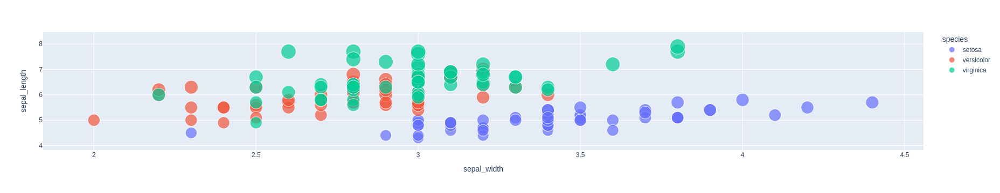

In [38]:
import plotly.io as pio
import plotly.express as px
import plotly.offline as py

df = px.data.iris()
fig = px.scatter(df, x="sepal_width", y="sepal_length", color="species", size="sepal_length")
fig

In the following analysis, we will be using the 3sec-utterance version of the dataset.

## 1) Loading Data

In [3]:
#read wav files' paths
wav_dirs = sorted(glob('datasets/scripted_spont_dataset/preprocessed_audios_dur3sec/*'))
wav_files = sorted(glob('datasets/scripted_spont_dataset/preprocessed_audios_dur3sec/*/*.wav'))
print(f'{len(wav_files)} samples')

6471 samples


In [4]:
#balancing the number of audio files in each label (i.e. to have equal number of scripted vs spontaneous samples per subject)
files = []
for wav_dir in wav_dirs:
    wav_files = np.array(sorted(glob(f'{wav_dir}/*.wav')))
    ids = np.array(list(map(lambda x: os.path.basename(x).split('_')[0], wav_files)))
    labels = np.array(list(map(lambda x: os.path.basename(x).split('_')[3], wav_files)))
    min_label = min(Counter(labels).values())
    script_files = [file for file in wav_files if os.path.basename(file).split('_')[3] == 'script'][:min_label]
    spon_files = [file for file in wav_files if os.path.basename(file).split('_')[3] == 'spon'][:min_label]
    files += spon_files + script_files
wav_files = files

In [5]:
#extract metadata from path (Script VS Spon data)
wav_names = np.array(list(map(lambda x: os.path.basename(x), wav_files)))
gender = np.array(list(map(lambda x: os.path.basename(x).split('_')[1], wav_files)))
speaker_ids = np.array(list(map(lambda x: os.path.basename(x).split('_')[0], wav_files)))
labels = np.array(list(map(lambda x: os.path.basename(x).split('_')[3], wav_files)))

In [6]:
#load audio files as torch tensors to get ready for feature extraction
audio_tensor_list = load_dataset(wav_files)
len(audio_tensor_list)

Loading Audio Files...: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5816/5816 [00:11<00:00, 491.42it/s]


5816

## 2) Generating BYOL-S Embeddings

In order to generate speech embeddings using BYOL-S model, we installed our [package](https://github.com/GasserElbanna/serab-byols) to extract the needed features and use the model checkpoints.

In [8]:
#generate speech embeddings
_CHECKPOINT_PATH = 'serab-byols/checkpoints/default2048_BYOLAs64x96-2105311814-e100-bs256-lr0003-rs42.pth'
_CONFIG_PATH = 'serab-byols/serab_byols/config.yaml'
_MODEL_NAME = 'default'
byols_embeddings = generate_speech_embeddings(audio_tensor_list, model_name=_MODEL_NAME, config_path=_CONFIG_PATH, checkpoint_path=_CHECKPOINT_PATH)
byols_embeddings.shape

Generating Embeddings...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5816/5816 [00:08<00:00, 673.46it/s]


(5816, 2048)

## 3) Analysis in High dimension

### 3.1 Prepare data for computing cosine distances in the original dimensions

In [10]:
#create dataframe with all dataset metadata
data = {'Speaker_ID':speaker_ids, 'Gender':gender, 'Label':labels, 'Audio_File':wav_names}
df = pd.DataFrame(data=data)
df.head()

,Speaker_ID,Gender,Label,Audio_File
0,049,F,spon,049_F_QNA_spon_000.wav
1,049,F,spon,049_F_QNA_spon_001.wav
2,049,F,spon,049_F_QNA_spon_002.wav
3,049,F,spon,049_F_QNA_spon_003.wav
4,049,F,spon,049_F_QNA_spon_004.wav


In [11]:
#add embeddings to original dataframe
df_embeddings = pd.DataFrame(byols_embeddings)
df_embeddings = df_embeddings.add_prefix('Embeddings_')
df = pd.concat([df, df_embeddings], axis=1)
df.head()

,Speaker_ID,Gender,Label,Audio_File,Embeddings_0,Embeddings_1,Embeddings_2,Embeddings_3,Embeddings_4,Embeddings_5,...,Embeddings_2038,Embeddings_2039,Embeddings_2040,Embeddings_2041,Embeddings_2042,Embeddings_2043,Embeddings_2044,Embeddings_2045,Embeddings_2046,Embeddings_2047
0,049,F,spon,049_F_QNA_spon_000.wav,11.017128,18.404051,29.074728,20.215780,18.257122,21.123589,...,62.339931,0.0,0.0,0.000000,14.587563,0.0,21.034172,33.224510,0.000000,16.484455
1,049,F,spon,049_F_QNA_spon_001.wav,9.761239,15.675602,22.369465,23.779690,35.791744,24.486591,...,26.223724,0.0,0.0,10.639882,15.066996,0.0,18.059189,22.209677,0.000000,43.085747
2,049,F,spon,049_F_QNA_spon_002.wav,12.330554,30.149439,33.027752,27.381170,42.258984,25.278389,...,17.156191,0.0,0.0,9.428810,17.106951,0.0,9.566128,10.364550,0.000000,22.379662
3,049,F,spon,049_F_QNA_spon_003.wav,5.156247,15.501472,46.504688,37.605148,34.845406,23.022125,...,14.043375,0.0,0.0,20.206833,12.760090,0.0,0.000000,6.830586,0.000000,32.307549
4,049,F,spon,049_F_QNA_spon_004.wav,11.879240,24.170506,12.805248,15.383516,32.950447,24.960428,...,26.416452,0.0,0.0,11.379996,15.376729,0.0,10.306218,20.553129,8.987949,22.359293


In [12]:
#create distance-based dataframe between all data samples in a square form
pairwise = pd.DataFrame(
    squareform(pdist(df.iloc[:, 5:], metric='cosine')),
    columns = df['Audio_File'],
    index = df['Audio_File']
)

In [10]:
#move from square form DF to long form DF
long_form = pairwise.unstack()
#rename columns and turn into a dataframe
long_form.index.rename(['Sample_1', 'Sample_2'], inplace=True)
long_form = long_form.to_frame('Distance').reset_index()
#remove the distances computed between same samples (distance = 0)
long_form = long_form.loc[long_form['Sample_1'] != long_form['Sample_2']]
long_form.sample(10)

,Sample_1,Sample_2,Distance
10385693,057_M_LPP_script_017.wav,068_F_QNA_spon_081.wav,0.091781
33724346,133_M_LPP_script_032.wav,064_F_QNA_spon_048.wav,0.141883
9742706,057_M_ST1_spon_021.wav,053_M_QNA_spon_034.wav,0.107057
27881647,071_F_ST2_spon_004.wav,132_M_NWS_script_006.wav,0.138506
18767895,064_F_QNA_spon_096.wav,132_M_DHR_script_013.wav,0.164457
22257794,066_M_NWS_script_005.wav,133_M_LPP_script_012.wav,0.148208
25958761,069_F_NWS_script_001.wav,058_F_DHR_script_008.wav,0.091862
33540836,133_M_LPP_script_000.wav,133_M_LPP_script_014.wav,0.055446
17452194,063_F_QNA_spon_088.wav,068_F_HT2_script_011.wav,0.087165
29060708,072_F_QNA_spon_076.wav,067_F_DHR_script_029.wav,0.075196


In [11]:
#add columns for meta-data
long_form['Gender'] = long_form.apply(lambda row: row['Sample_1'].split('_')[1] if row['Sample_1'].split('_')[1] == row['Sample_2'].split('_')[1] else 'Different', axis=1)
long_form['Label'] = long_form.apply(lambda row: row['Sample_1'].split('_')[3] if row['Sample_1'].split('_')[3] == row['Sample_2'].split('_')[3] else 'Different', axis=1)
long_form['ID'] = long_form.apply(lambda row: row['Sample_1'].split('_')[0] if row['Sample_1'].split('_')[0] == row['Sample_2'].split('_')[0] else 'Different', axis=1)
long_form.sample(10)

,Sample_1,Sample_2,Distance,Gender,Label,ID
12135938,059_M_QNA_spon_008.wav,066_M_HT2_script_013.wav,0.073437,M,Different,Different
4343249,052_M_ST2_spon_029.wav,070_M_QNA_spon_041.wav,0.061963,M,spon,Different
23356626,067_F_LPP_script_007.wav,132_M_QNA_spon_016.wav,0.277809,Different,Different,Different
5374378,053_M_QNA_spon_052.wav,050_M_LPP_script_009.wav,0.198682,M,Different,Different
18253434,064_F_QNA_spon_008.wav,062_F_DHR_script_019.wav,0.101348,F,Different,Different
6128387,053_M_LPP_script_018.wav,068_F_QNA_spon_087.wav,0.130988,Different,Different,Different
4056286,052_M_ST1_spon_020.wav,061_M_QNA_spon_030.wav,0.117163,M,spon,Different
3216359,051_F_DHR_script_015.wav,049_F_DHR_script_013.wav,0.077539,F,script,Different
27723465,071_F_QNA_spon_086.wav,069_F_HT2_script_015.wav,0.087290,F,Different,Different
12310612,059_M_QNA_spon_038.wav,067_F_DHR_script_013.wav,0.249902,Different,Different,Different


In [12]:
#remove distances computed between different speakers and different labels
df = long_form.loc[(long_form['Gender']!='Different') & (long_form['Label']!='Different') & (long_form['ID']!='Different')]
df.sample(10)

,Sample_1,Sample_2,Distance,Gender,Label,ID
9534035,057_M_QNA_spon_035.wav,057_M_QNA_spon_007.wav,0.068911,M,spon,057
18684129,064_F_QNA_spon_082.wav,064_F_QNA_spon_007.wav,0.058331,F,spon,064
3362202,051_F_HT2_script_008.wav,051_F_DHR_script_016.wav,0.065181,F,script,051
21534475,066_M_ST1_spon_016.wav,066_M_QNA_spon_057.wav,0.127320,M,spon,066
8981432,056_F_HT2_script_055.wav,056_F_HT2_script_039.wav,0.074613,F,script,056
29137332,072_F_QNA_spon_089.wav,072_F_QNA_spon_068.wav,0.069827,F,spon,072
9080255,056_F_LPP_script_013.wav,056_F_DHR_script_033.wav,0.079034,F,script,056
15176554,061_M_DHR_script_006.wav,061_M_DHR_script_007.wav,0.040533,M,script,061
26548717,070_M_QNA_spon_092.wav,070_M_QNA_spon_021.wav,0.084138,M,spon,070
23617021,068_F_QNA_spon_008.wav,068_F_QNA_spon_009.wav,0.089248,F,spon,068


### 3.2 Per Speaker Analysis

#### Here, we explore the differences in cosine distances for each speaker based on the labels (in this case scripted vs spontaneous speech).

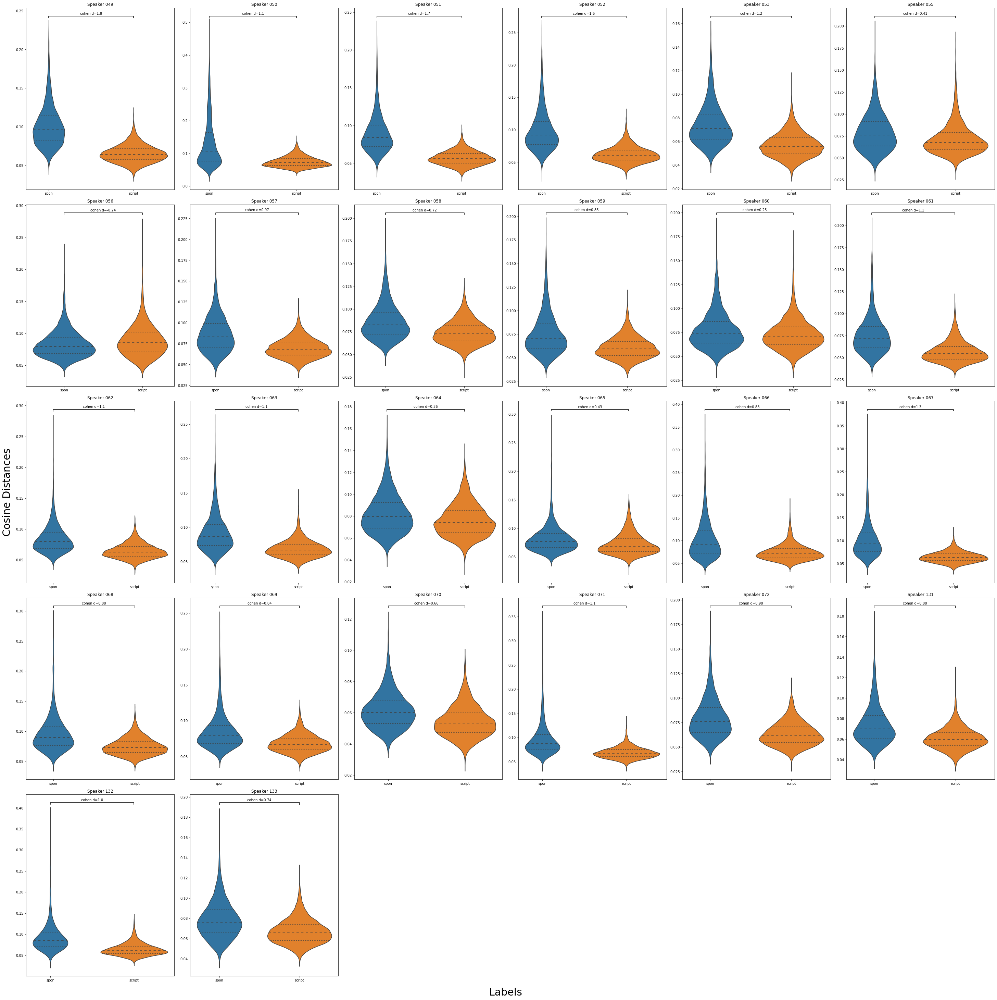

In [19]:
speakers = df['ID'].unique()
fig, ax = plt.subplots(5, 6, figsize=(40, 40))
ax = ax.flatten()
for i, speaker in enumerate(speakers):
    speaker_df = df.loc[(df['Sample_1'].str.contains(f'{speaker}_')) & (df['Sample_2'].str.contains(f'{speaker}_'))]
    sns.violinplot(data=speaker_df, x='Label', y='Distance', inner='quartile', ax=ax[i])
    ax[i].set(xlabel=None, ylabel=None)
    ax[i].set_title(f'Speaker {speaker}')
    
    # statistical annotation
    d=cohend(speaker_df['Distance'].loc[(speaker_df.Label=='spon')], speaker_df['Distance'].loc[(speaker_df.Label=='script')])
    x1, x2 = 0, 1
    y, h, col = speaker_df['Distance'].max() + speaker_df['Distance'].max()*0.05, speaker_df['Distance'].max()*0.01, 'k'
    ax[i].plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, c=col)
    ax[i].text((x1+x2)*.5, y+(h*1.5), f'cohen d={d:.2}', ha='center', va='bottom', color=col)


fig.text(0.5, -0.01, 'Labels', ha='center', fontsize=30)
fig.text(-0.01, 0.5, 'Cosine Distances', va='center', rotation='vertical', fontsize=30)
for empty_ax in ax[speakers.shape[0]:]:
    empty_ax.set_visible(False)
plt.tight_layout()
plt.savefig('perspeaker_scriptvsspon_cosinedist.png')

### 3.3 Gender Analysis

#### Here, we explore the gender effect on embeddings distances.

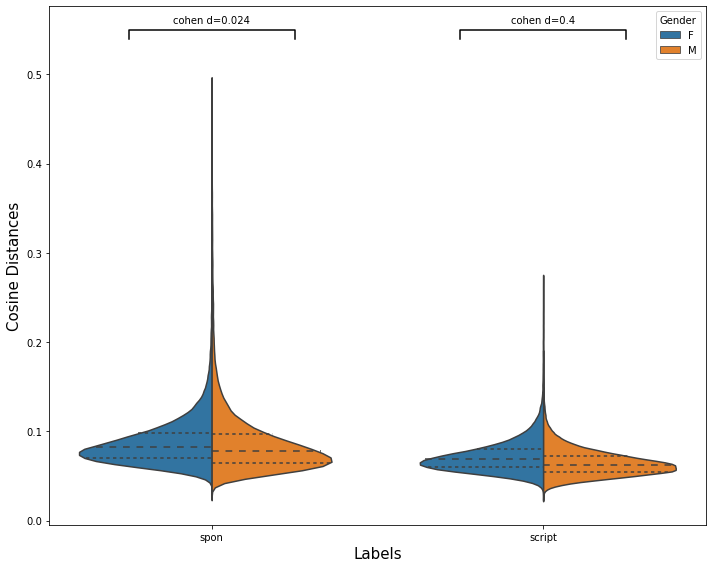

In [20]:
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
sns.violinplot(data=df, x='Label', y='Distance', hue='Gender', inner='quartile', split=True, ax=ax)
ax.set_xlabel('Labels', fontsize=15)
ax.set_ylabel('Cosine Distances', fontsize=15)

# statistical annotation
d1=cohend(df['Distance'].loc[(df.Label=='spon')&(df.Gender=='F')], df['Distance'].loc[(df.Label=='spon')&(df.Gender=='M')])
d2=cohend(df['Distance'].loc[(df.Label=='script')&(df.Gender=='F')], df['Distance'].loc[(df.Label=='script')&(df.Gender=='M')])
x1, x2, x3, x4 = -0.25, 0.25, 0.75, 1.25
y, h, col = df['Distance'].max() + 0.05, 0.01, 'k'
plt.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, c=col)
plt.plot([x3, x3, x4, x4], [y, y+h, y+h, y], lw=1.5, c=col)
plt.text((x1+x2)*.5, y+(h*1.5), f'cohen d={d1:.2}', ha='center', va='bottom', color=col)
plt.text((x3+x4)*.5, y+(h*1.5), f'cohen d={d2:.2}', ha='center', va='bottom', color=col)

plt.tight_layout()
plt.savefig('gender_scriptvsspon_cosinedist.png')

### 3.4 Overall Label Analysis

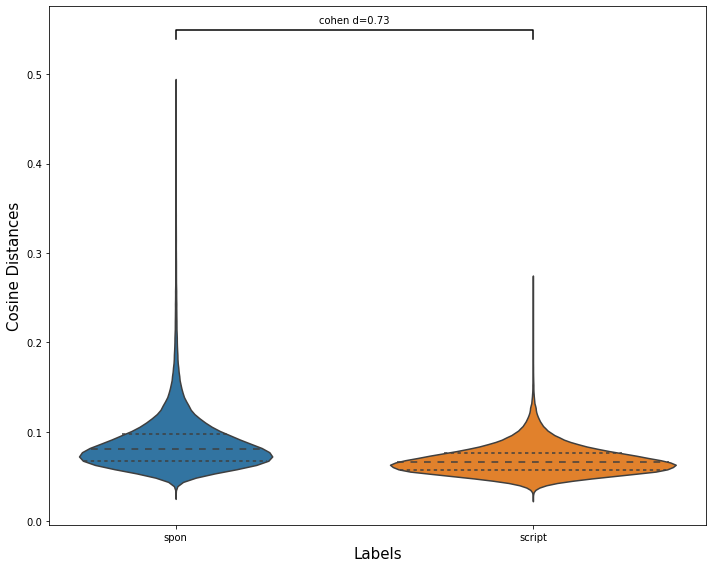

In [21]:
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
sns.violinplot(data=df, x='Label', y='Distance', inner='quartile', ax=ax)
ax.set_xlabel('Labels', fontsize=15)
ax.set_ylabel('Cosine Distances', fontsize=15)

# statistical annotation
d=cohend(df['Distance'].loc[(df.Label=='spon')], df['Distance'].loc[(df.Label=='script')])
x1, x2 = 0, 1
y, h, col = df['Distance'].max() + 0.05, 0.01, 'k'
plt.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, c=col)
plt.text((x1+x2)*.5, y+(h*1.5), f'cohen d={d:.2}', ha='center', va='bottom', color=col)

plt.tight_layout()
plt.savefig('overalllabel_scriptvsspon_cosinedist.png')

## <span style="color:red"><div style="text-align: justify">Let's try the same *overall label analysis* but with Hybrid BYOL-S model instead of BYOL-S.</div></span>

In [6]:
#generate speech embeddings
_CHECKPOINT_PATH = 'serab-byols/checkpoints/cvt_s1-d1-e64_s2-d1-e256_s3-d1-e512_BYOLAs64x96-osandbyolaloss6373-e100-bs256-lr0003-rs42.pth'
_CONFIG_PATH = 'serab-byols/serab_byols/config.yaml'
_MODEL_NAME = 'cvt'
hybrid_byols_embeddings = generate_speech_embeddings(audio_tensor_list, model_name=_MODEL_NAME, config_path=_CONFIG_PATH, checkpoint_path=_CHECKPOINT_PATH)
hybrid_byols_embeddings.shape

Generating Embeddings...: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 5816/5816 [00:31<00:00, 187.21it/s]


(5816, 2048)

In [7]:
#create dataframe with all dataset metadata
data = {'Speaker_ID':speaker_ids, 'Gender':gender, 'Label':labels, 'Audio_File':wav_names}
df = pd.DataFrame(data=data)

#add embeddings to original dataframe
df_embeddings = pd.DataFrame(hybrid_byols_embeddings)
df_embeddings = df_embeddings.add_prefix('Embeddings_')
df = pd.concat([df, df_embeddings], axis=1)
df.head()

,Speaker_ID,Gender,Label,Audio_File,Embeddings_0,Embeddings_1,Embeddings_2,Embeddings_3,Embeddings_4,Embeddings_5,...,Embeddings_2038,Embeddings_2039,Embeddings_2040,Embeddings_2041,Embeddings_2042,Embeddings_2043,Embeddings_2044,Embeddings_2045,Embeddings_2046,Embeddings_2047
0,049,F,spon,049_F_QNA_spon_000.wav,4.103270,4.120546,1.352512,2.141582,5.571535,7.527884,...,-0.765369,1.186654,4.831436,2.394095,4.626908,3.449088,0.675361,5.160479,-1.288000,3.524813
1,049,F,spon,049_F_QNA_spon_001.wav,4.016471,3.548981,1.540483,3.556495,5.171679,3.926869,...,-1.894987,1.383071,7.511224,2.646015,4.244521,3.033823,1.061591,3.937183,-1.092015,2.923203
2,049,F,spon,049_F_QNA_spon_002.wav,4.617970,3.027414,1.438074,1.951793,6.054664,4.841012,...,-2.219533,1.527902,8.714240,3.416264,4.199082,3.409757,1.113673,5.768929,-1.448857,3.461106
3,049,F,spon,049_F_QNA_spon_003.wav,2.400469,2.728070,1.427721,0.889393,3.599642,2.332925,...,-2.107188,1.960670,5.702475,2.164266,4.269603,2.287229,1.451889,5.439458,-1.249272,2.927788
4,049,F,spon,049_F_QNA_spon_004.wav,4.805633,3.500207,1.665125,2.143503,6.033761,6.836559,...,-1.603157,0.359591,4.910415,4.722897,3.070096,2.729329,1.369577,6.422819,-1.993020,2.722548


In [8]:
#create distance-based dataframe between all data samples in a square form
pairwise = pd.DataFrame(
    squareform(pdist(df.iloc[:, 5:], metric='cosine')),
    columns = df['Audio_File'],
    index = df['Audio_File']
)
#move from square form DF to long form DF
long_form = pairwise.unstack()
#rename columns and turn into a dataframe
long_form.index.rename(['Sample_1', 'Sample_2'], inplace=True)
long_form = long_form.to_frame('Distance').reset_index()
#remove the distances computed between same samples (distance = 0)
long_form = long_form.loc[long_form['Sample_1'] != long_form['Sample_2']]
#add columns for meta-data
long_form['Gender'] = long_form.apply(lambda row: row['Sample_1'].split('_')[1] if row['Sample_1'].split('_')[1] == row['Sample_2'].split('_')[1] else 'Different', axis=1)
long_form['Label'] = long_form.apply(lambda row: row['Sample_1'].split('_')[3] if row['Sample_1'].split('_')[3] == row['Sample_2'].split('_')[3] else 'Different', axis=1)
long_form['ID'] = long_form.apply(lambda row: row['Sample_1'].split('_')[0] if row['Sample_1'].split('_')[0] == row['Sample_2'].split('_')[0] else 'Different', axis=1)
#remove distances computed between different speakers and different labels
df = long_form.loc[(long_form['Gender']!='Different') & (long_form['Label']!='Different') & (long_form['ID']!='Different')]
df.sample(10)

,Sample_1,Sample_2,Distance,Gender,Label,ID
12378615,059_M_QNA_spon_050.wav,059_M_QNA_spon_089.wav,0.066351,M,spon,059
17445129,063_F_QNA_spon_087.wav,063_F_QNA_spon_033.wav,0.089789,F,spon,063
27264323,071_F_QNA_spon_007.wav,071_F_QNA_spon_051.wav,0.074763,F,spon,071
23407562,067_F_LPP_script_016.wav,067_F_HT2_script_001.wav,0.056402,F,script,067
29689915,072_F_LPP_script_011.wav,072_F_DHR_script_021.wav,0.077789,F,script,072
2914298,051_F_ST2_spon_016.wav,051_F_ST1_spon_024.wav,0.076822,F,spon,051
27217659,070_M_NWS_script_008.wav,070_M_DHR_script_019.wav,0.058413,M,script,070
23209800,067_F_HT2_script_013.wav,067_F_DHR_script_017.wav,0.070252,F,script,067
14548268,060_F_NWS_script_006.wav,060_F_HT2_script_017.wav,0.067217,F,script,060
4362677,052_M_ST2_spon_033.wav,052_M_ST1_spon_000.wav,0.090907,M,spon,052


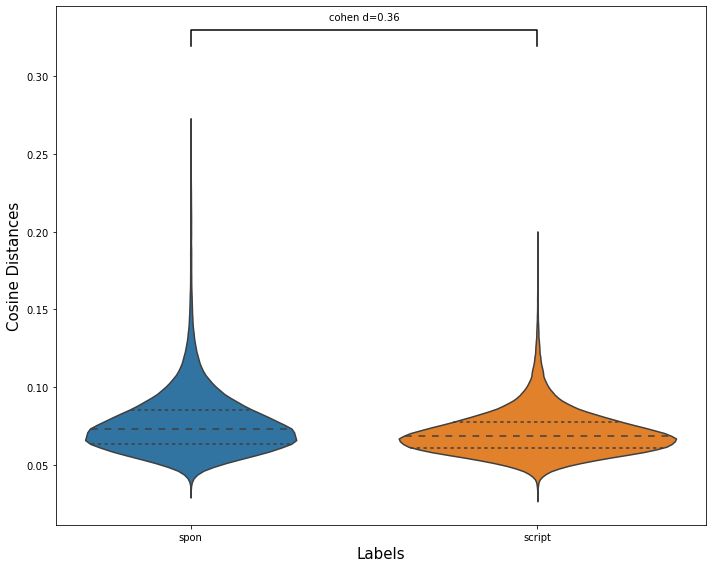

In [10]:
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
sns.violinplot(data=df, x='Label', y='Distance', inner='quartile', ax=ax)
ax.set_xlabel('Labels', fontsize=15)
ax.set_ylabel('Cosine Distances', fontsize=15)

# statistical annotation
d=cohend(df['Distance'].loc[(df.Label=='spon')], df['Distance'].loc[(df.Label=='script')])
x1, x2 = 0, 1
y, h, col = df['Distance'].max() + 0.05, 0.01, 'k'
plt.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, c=col)
plt.text((x1+x2)*.5, y+(h*1.5), f'cohen d={d:.2}', ha='center', va='bottom', color=col)

plt.tight_layout()

## 4) Dimensionality Reduction

#### The previous analysis showed how well the model is capable of grouping the uttereances of the same speaker in different cases (scripted and spontaneous) in the embedding space (high dimension). That being said, we will replicate the same analysis but in the lower dimension space to visualize the impact of speaking styles on voice identity perception.

#### Accordingly, we will utilize different kind of dimensionality reduction such as PCA, tSNE, UMAP and PaCMAP to get a better idea of how the speakers' samples are clustered together in 2D. However, one constraint is that these methods are sensitive to their hyperparameters (except PCA) which could imapct our interpretation of the results. Thus, a grid search across the hyperparameters for each method is implemented.

#### Another issue would be quantifying the ability of these methods to perserve the distances amongst samples in the high dimension and present it in a lower dimension. To address this, we are using two metrics KNN and CPD that represent the ability of the algorithm to preserve local and global structures of the original embedding space, respectively. Both metrics are adopted from this [paper](https://www.nature.com/articles/s41467-019-13056-x) in which they define both metrics as follows:

* KNN: The fraction of k-nearest neighbours in the original high-dimensional data that are preserved as k-nearest neighbours in the embedding. KNN quantifies preservation of the local, or microscopic structure. The value of K used here is the min number of samples a speaker would have in the original space.

* CPD: Spearman correlation between pairwise distances in the high-dimensional space and in the embedding. CPD quantifies preservation of the global, or macroscropic structure. Computed across all pairs among 1000 randomly chosen points with replacement. 

#### Consequently, we present the results from dimensionality reduction methods in two ways, one optimimizing local structure metric (KNN) and the other optimizing global structure metric (CPD).

### <a id='another_cell'></a> 4.1 Dimensionality Reduction Methods Comparison

In [79]:
script_df = pd.read_csv('script_dataset.csv', header=[0,1,2])
script_df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
spon_df = pd.read_csv('spon_dataset.csv', header=[0,1,2])
spon_df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
metrics = pd.read_csv('scriptvsspon_metrics.csv')

Method        PCA                                        tSNE  \
     Optimized Metric      Local                Global                 Local   
                  Dim       Dim1       Dim2       Dim1       Dim2       Dim1   
0                   0   7.094680 -17.142450   7.094680 -17.142450 -21.737820   
1                   1  -7.398114  -4.286068  -7.398114  -4.286068 -10.177902   
2                   2   2.681128  -8.947656   2.681128  -8.947656 -15.955649   
3                   3  -7.384286   6.364989  -7.384286   6.364989  -4.300466   
4                   4   1.524194 -12.589486   1.524194 -12.589486 -15.969744   
...               ...        ...        ...        ...        ...        ...   
2903             2903  -1.734350   8.281439  -1.734350   8.281439  14.545728   
2904             2904 -11.845043   6.769116 -11.845043   6.769116  15.088892   
2905             2905  -1.566380  12.781311  -1.566380  12.781311  14.266279   
2906             2906 -21.562778   0.860724 -21.562778   0.860724  18.751270   
2907             2907  -1.217097  13.085301  -1.217097  13.085301  14.002843   

                                          UMAP                       \
                   Global                Local               Global   
          Dim2       Dim1       Dim2      Dim1       Dim2      Dim1   
0     0.877386  17.829542 -35.943344  7.992977   9.596833  6.952017   
1     4.603195   2.129793 -14.613787  6.127039  10.866789  2.470988   
2     0.832253  17.884207 -23.005457  7.053411  10.033836  4.651956   
3    -0.574696   2.335789 -14.528165  5.790949  10.342254  1.557014   
4     0.839784  17.889452 -22.995070  7.226274   9.882161  5.364577   
...        ...        ...        ...       ...        ...       ...   
2903 -0.380377 -21.885998  12.991421 -2.030515   6.930655 -0.356512   
2904  0.108998 -24.042133  12.759280 -2.053507   7.119851 -1.778230   
2905 -2.974313 -18.688118   9.550365 -2.050378   6.687838 -1.020057   
2906  0.090794 -25.806938  12.872682 -2.244093   7.365062 -3.006572   
2907 -2.595421 -18.712725  10.040182 -1.910964   6.640241 -0.662667   

                    PaCMAP                                   \
                     Local                Global              
           Dim2       Dim1       Dim2       Dim1       Dim2   
0     12.548631   9.132633  -8.075318  10.694435 -10.300371   
1     13.118707   4.671931 -10.713258   8.455777   1.060666   
2     12.161524   7.476809  -8.305224  11.078800  -8.386533   
3     11.685680  -5.870876   9.021783   8.515469   1.662574   
4     12.365853   7.622736  -8.938698  10.664289  -8.344880   
...         ...        ...        ...        ...        ...   
2903  10.349532  -8.828900   5.743923  -9.776178  -1.258525   
2904  10.295985  -8.966543   7.550015 -10.324492  -0.154405   
2905  10.603956  -9.274688   5.392169  -9.845168  -1.578224   
2906  10.894928 -12.020906   7.945750 -12.486074  -0.840273   
2907  10.294886  -9.043740   5.645683  -9.314788  -0.940633   

                    wav_file   id gender  
                                          
                                          
0     049_F_QNA_spon_000.wav   49      F  
1     049_F_QNA_spon_001.wav   49      F  
2     049_F_QNA_spon_002.wav   49      F  
3     049_F_QNA_spon_003.wav   49      F  
4     049_F_QNA_spon_004.wav   49      F  
...                      ...  ...    ...  
2903  133_M_ST2_spon_001.wav  133      M  
2904  133_M_ST2_spon_002.wav  133      M  
2905  133_M_ST2_spon_003.wav  133      M  
2906  133_M_ST2_spon_004.wav  133      M  
2907  133_M_ST2_spon_005.wav  133      M  

[2908 rows x 20 columns]

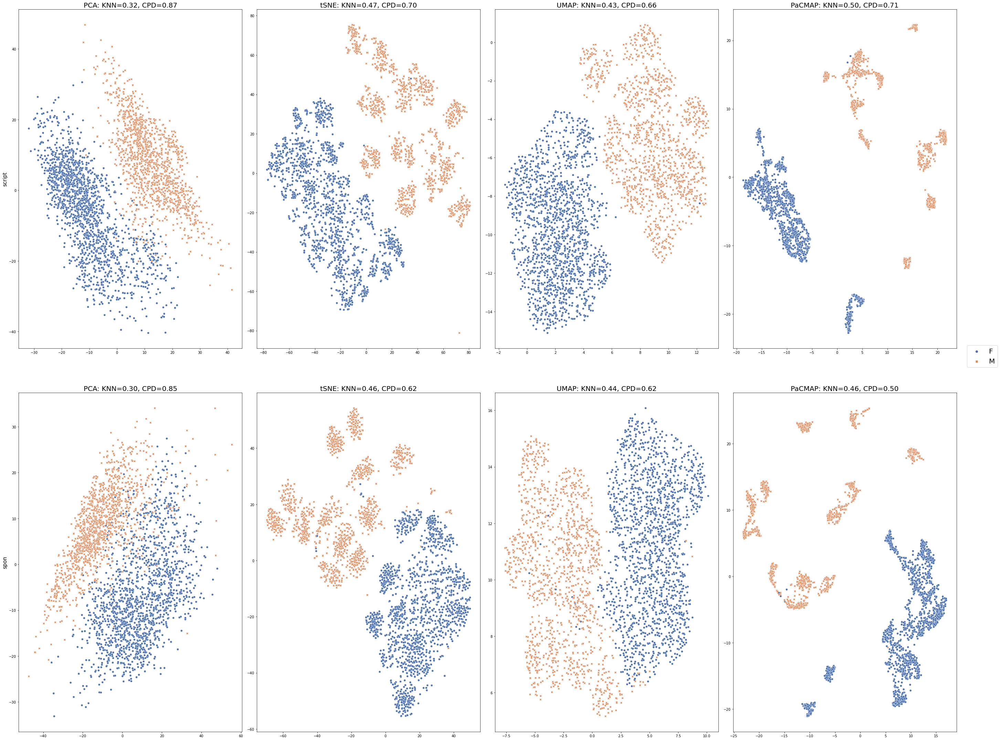

In [7]:
fig, ax = plt.subplots(2, 4, figsize=(40, 30))
optimize = 'Global'
labels = ['script', 'spon']
metrics = pd.read_csv('scriptvsspon_metrics.csv')
reducer_names, params_list = get_reducers_params()
for i, label in enumerate(labels):
    df = pd.read_csv(f'{label}_dataset.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
    for j, name in enumerate(reducer_names):
        max_idx = metrics[optimize].loc[(metrics.Protocol==label)&(metrics.Method==name)].idxmax()
        metric = [metrics['Local'].iloc[max_idx], metrics['Global'].iloc[max_idx]]
        visualize_embeddings(df, 'gender', metrics=metric, axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(label, fontsize=15)
ax[i,j].legend(bbox_to_anchor=(1.2, 1.15), fontsize=20)
plt.tight_layout()

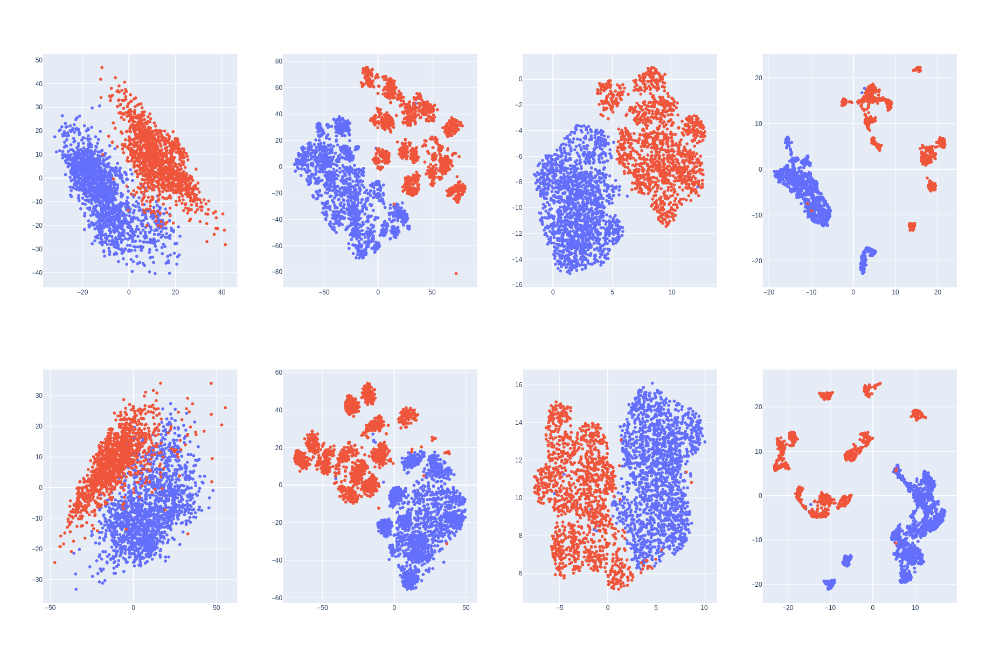

In [10]:
import plotly
from IPython.display import display
from IPython.display import IFrame
# from html import HTML
fig = make_subplots(rows=2, cols=4)
optimize = 'Global'
labels = ['script', 'spon']
metrics = pd.read_csv('scriptvsspon_metrics.csv')
reducer_names, params_list = get_reducers_params()
for i, label in enumerate(labels):
    df = pd.read_csv(f'{label}_dataset.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
    for j, name in enumerate(reducer_names):
        max_idx = metrics[optimize].loc[(metrics.Protocol==label)&(metrics.Method==name)].idxmax()
        metric = [metrics['Local'].iloc[max_idx], metrics['Global'].iloc[max_idx]]
        visualize_embeddings(df, 'gender', metrics=metric, axis=fig, opt_structure=optimize, red_name=name, plot_type='plotly', row=i+1, col=j+1, hovertext=df['wav_file'], label=label)
fig.update_layout(
    autosize=False,
    width=1600,
    height=1200, showlegend=False,)
fig.show()

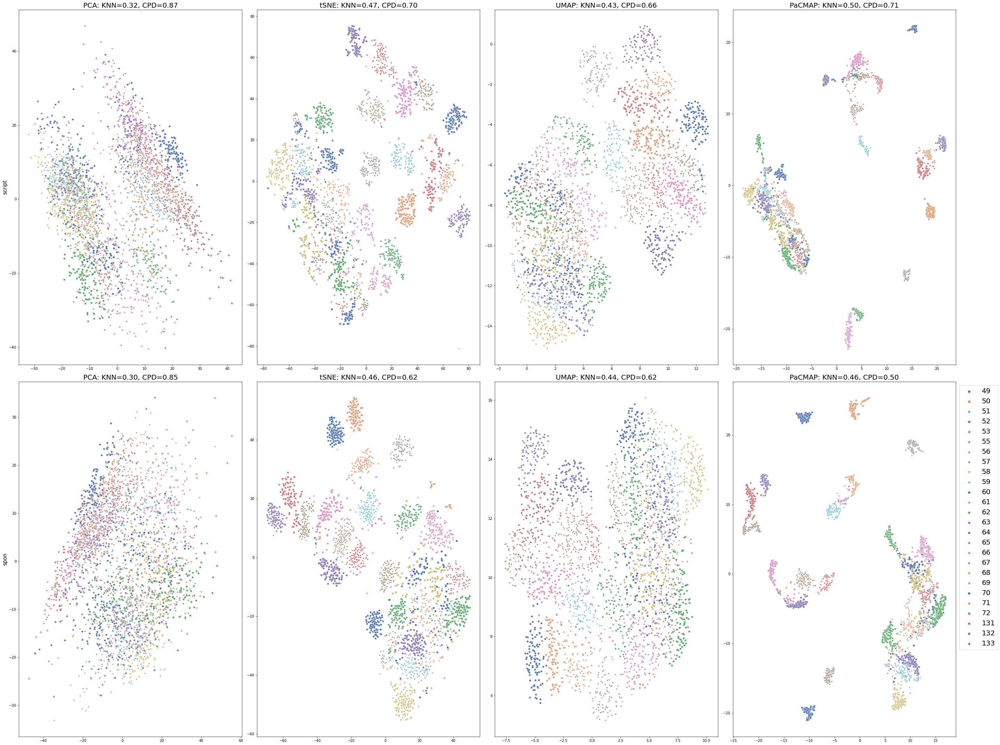

In [12]:
fig, ax = plt.subplots(2, 4, figsize=(40, 30))
optimize = 'Global'
labels = ['script', 'spon']
metrics = pd.read_csv('scriptvsspon_metrics.csv')
reducer_names, params_list = get_reducers_params()
for i, label in enumerate(labels):
    df = pd.read_csv(f'{label}_dataset.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
    for j, name in enumerate(reducer_names):
        max_idx = metrics[optimize].loc[(metrics.Protocol==label)&(metrics.Method==name)].idxmax()
        metric = [metrics['Local'].iloc[max_idx], metrics['Global'].iloc[max_idx]]
        visualize_embeddings(df, 'id', metrics=metric, axis=ax[i, j], opt_structure=optimize, red_name=name, plot_type='sns')
    ax[i, 0].set_ylabel(label, fontsize=15)
ax[i,j].legend(bbox_to_anchor=(1, 1), fontsize=20)
plt.tight_layout()

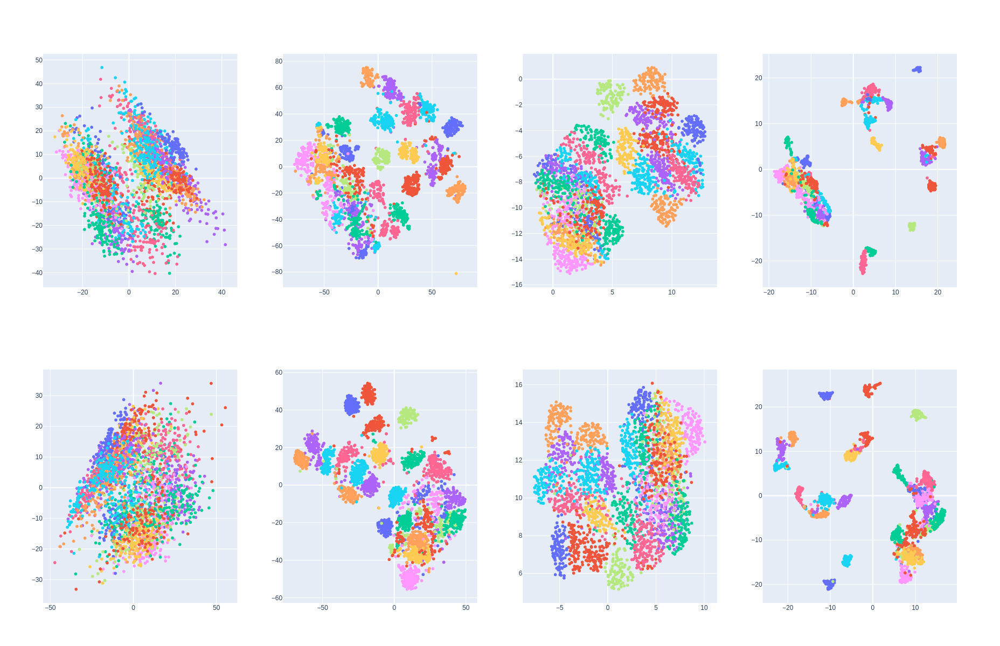

In [13]:
fig = make_subplots(rows=2, cols=4)
optimize = 'Global'
labels = ['script', 'spon']
metrics = pd.read_csv('scriptvsspon_metrics.csv')
reducer_names, params_list = get_reducers_params()
for i, label in enumerate(labels):
    df = pd.read_csv(f'{label}_dataset.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
    for j, name in enumerate(reducer_names):
        max_idx = metrics[optimize].loc[(metrics.Protocol==label)&(metrics.Method==name)].idxmax()
        metric = [metrics['Local'].iloc[max_idx], metrics['Global'].iloc[max_idx]]
        visualize_embeddings(df, 'id', metrics=metric, axis=fig, opt_structure=optimize, red_name=name, plot_type='plotly', row=i+1, col=j+1, hovertext=df['wav_file'], label=label)
fig.update_layout(
    autosize=False,
    width=1600,
    height=1200, showlegend=False,)
fig.show()

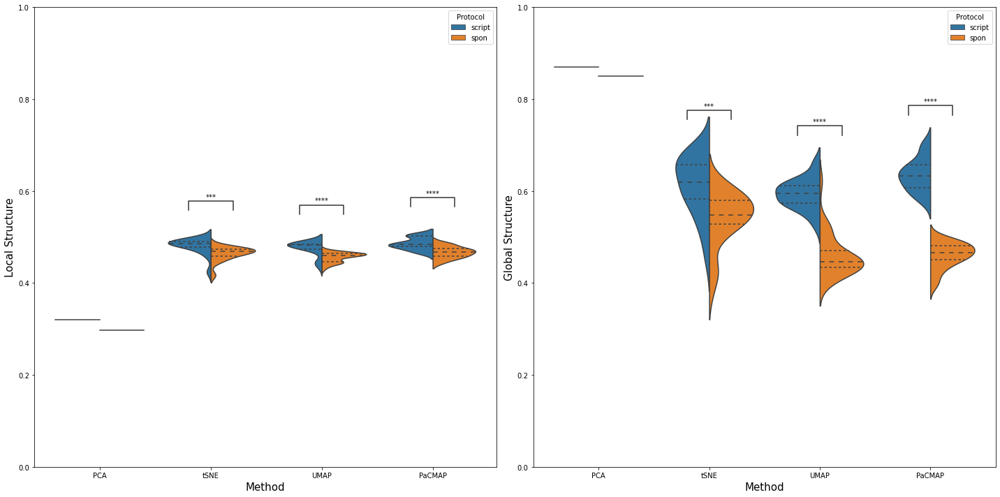

In [182]:
df = pd.read_csv('scriptvsspon_metrics.csv')
fig, ax = plt.subplots(1, 2, figsize=(20, 10))
ax = ax.T.flatten()
sns.violinplot(data=df, x='Method', y='Local', hue='Protocol', ax=ax[0], split=True, inner='quartile')
ax[0].set_ylabel('Local Structure', fontsize=15)
ax[0].set_xlabel('Method', fontsize=15)
ax[0].set_ylim([0,1])
add_stat_annotation(ax[0], data=df, x='Method', y='Local', hue='Protocol',
                    box_pairs=[
                                 (("tSNE", 'script'), ("tSNE", 'spon')),
                                 (("UMAP", 'script'), ("UMAP", 'spon')),
                                 (("PaCMAP", 'script'), ("PaCMAP", 'spon'))
                                ],
                    test='t-test_ind', text_format='star', loc='inside', verbose=0)

sns.violinplot(data=df, x='Method', y='Global', hue='Protocol', ax=ax[1], split=True, inner='quartile')
ax[1].set_ylabel('Global Structure', fontsize=15)
ax[1].set_xlabel('Method', fontsize=15)
ax[1].set_ylim([0,1])
add_stat_annotation(ax[1], data=df, x='Method', y='Global', hue='Protocol',
                    box_pairs=[
                                 (("tSNE", 'script'), ("tSNE", 'spon')),
                                 (("UMAP", 'script'), ("UMAP", 'spon')),
                                 (("PaCMAP", 'script'), ("PaCMAP", 'spon'))
                                ],
                    test='t-test_ind', text_format='star', loc='inside', verbose=0)
fig.tight_layout()

### 4.2 Distance in Lower Dimensions

In [217]:
labels = ['script', 'spon']
dfs = []
for label in labels:
    df = pd.read_csv(f'{label}_dataset.csv', header=[0,1,2])
    df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
    pacmap_global_df = df.loc[:, ('PaCMAP', 'Global')]
    pacmap_global_df['wav_file'] = df['wav_file']; pacmap_global_df['label'] = label
    dfs.append(pacmap_global_df)
df = pd.concat(dfs, axis=0)
df.sample(10)

,Dim1,Dim2,wav_file,label
948,-16.733345,-1.996756,058_F_HT2_script_001.wav,script
1696,-7.589085,-6.348401,065_F_DHR_script_010.wav,script
2734,-13.431674,-4.555548,132_M_QNA_spon_049.wav,spon
1765,-7.870420,-6.359378,065_F_LPP_script_016.wav,script
1128,5.016654,5.860515,059_M_LPP_script_022.wav,script
1121,4.929832,5.776471,059_M_LPP_script_015.wav,script
428,16.376358,3.609564,052_M_NWS_script_002.wav,script
2000,5.581617,-12.904393,067_F_QNA_spon_083.wav,spon
1281,-1.567527,11.817277,061_M_QNA_spon_029.wav,spon
2062,-12.941590,-5.509135,068_F_HT2_script_004.wav,script


In [219]:
#create distance-based dataframe between all data samples in a square form
pairwise = pd.DataFrame(
    squareform(pdist(df.iloc[:, :2], metric='cosine')),
    columns = df['wav_file'],
    index = df['wav_file']
)

In [221]:
#move from square form DF to long form DF
long_form = pairwise.unstack()
#rename columns and turn into a dataframe
long_form.index.rename(['Sample_1', 'Sample_2'], inplace=True)
long_form = long_form.to_frame('Distance').reset_index()
#remove the distances computed between same samples (distance = 0)
long_form = long_form.loc[long_form['Sample_1'] != long_form['Sample_2']]
long_form.sample(10)

,Sample_1,Sample_2,Distance
29460525,069_F_QNA_spon_032.wav,072_F_DHR_script_025.wav,0.726305
16264862,133_M_DHR_script_015.wav,052_M_ST2_spon_022.wav,1.053295
18851113,052_M_QNA_spon_012.wav,063_F_DHR_script_001.wav,0.662966
26444879,064_F_QNA_spon_073.wav,071_F_QNA_spon_095.wav,0.012889
28205636,067_F_QNA_spon_024.wav,058_F_QNA_spon_038.wav,0.259614
4276696,056_F_HT2_script_048.wav,067_F_DHR_script_019.wav,0.183844
28975777,068_F_QNA_spon_048.wav,053_M_DHR_script_029.wav,0.395303
19771496,053_M_QNA_spon_055.wav,049_F_QNA_spon_004.wav,1.996565
11123129,066_M_NWS_script_008.wav,049_F_QNA_spon_029.wav,0.980920
23103239,059_M_QNA_spon_025.wav,068_F_LPP_script_002.wav,1.238760


In [223]:
#add columns for meta-data
long_form['Gender'] = long_form.apply(lambda row: row['Sample_1'].split('_')[1] if row['Sample_1'].split('_')[1] == row['Sample_2'].split('_')[1] else 'Different', axis=1)
long_form['Label'] = long_form.apply(lambda row: row['Sample_1'].split('_')[3] if row['Sample_1'].split('_')[3] == row['Sample_2'].split('_')[3] else 'Different', axis=1)
long_form['ID'] = long_form.apply(lambda row: row['Sample_1'].split('_')[0] if row['Sample_1'].split('_')[0] == row['Sample_2'].split('_')[0] else 'Different', axis=1)
long_form.sample(10)

,Sample_1,Sample_2,Distance,Gender,Label,ID
11829677,068_F_DHR_script_007.wav,133_M_QNA_spon_060.wav,0.050603,Different,Different,Different
2004548,052_M_DHR_script_023.wav,058_F_QNA_spon_030.wav,0.672418,Different,Different,Different
32927936,132_M_QNA_spon_068.wav,056_F_QNA_spon_008.wav,1.999721,Different,spon,Different
32933531,132_M_QNA_spon_069.wav,052_M_ST2_spon_035.wav,0.223480,M,spon,Different
11423077,067_F_HT2_script_013.wav,053_M_DHR_script_017.wav,1.999219,Different,script,Different
22509950,058_F_QNA_spon_056.wav,068_F_DHR_script_004.wav,0.411826,F,Different,Different
2862502,053_M_HT2_script_025.wav,058_F_NWS_script_003.wav,1.976306,Different,script,Different
29512461,069_F_QNA_spon_041.wav,068_F_HT2_script_019.wav,1.277754,F,Different,Different
7549556,061_M_HT2_script_016.wav,052_M_LPP_script_000.wav,0.004711,M,script,Different
6979211,060_F_HT2_script_017.wav,049_F_DHR_script_011.wav,0.610212,F,script,Different


In [224]:
#remove distances computed between different speakers and different labels
df = long_form.loc[(long_form['Gender']!='Different') & (long_form['Label']!='Different') & (long_form['ID']!='Different')]
df.sample(10)

,Sample_1,Sample_2,Distance,Gender,Label,ID
10517184,066_M_DHR_script_015.wav,066_M_HT2_script_024.wav,0.000549,M,script,066
9173513,064_F_DHR_script_012.wav,064_F_NWS_script_007.wav,0.106249,F,script,064
17997754,050_M_ST1_spon_004.wav,050_M_QNA_spon_044.wav,0.000895,M,spon,050
5630860,058_F_HT2_script_021.wav,058_F_HT2_script_025.wav,0.000425,F,script,058
25967078,063_F_QNA_spon_100.wav,063_F_QNA_spon_090.wav,0.002420,F,spon,063
31720064,072_F_QNA_spon_085.wav,072_F_QNA_spon_048.wav,0.036492,F,spon,072
2536298,053_M_DHR_script_000.wav,053_M_LPP_script_025.wav,0.001557,M,script,053
4409184,056_F_LPP_script_012.wav,056_F_DHR_script_012.wav,0.001254,F,script,056
19603322,053_M_QNA_spon_026.wav,053_M_QNA_spon_058.wav,0.350624,M,spon,053
16561024,133_M_HT2_script_027.wav,133_M_LPP_script_014.wav,0.000339,M,script,133


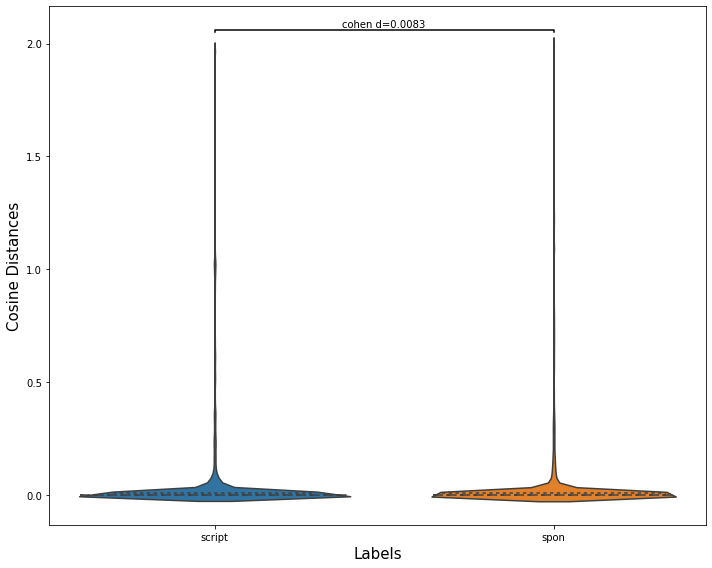

In [226]:
fig, ax = plt.subplots(1, 1, figsize=(10, 8))
sns.violinplot(data=df, x='Label', y='Distance', inner='quartile', ax=ax)
ax.set_xlabel('Labels', fontsize=15)
ax.set_ylabel('Cosine Distances', fontsize=15)

# statistical annotation
d=cohend(df['Distance'].loc[(df.Label=='spon')], df['Distance'].loc[(df.Label=='script')])
x1, x2 = 0, 1
y, h, col = df['Distance'].max() + 0.05, 0.01, 'k'
plt.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, c=col)
plt.text((x1+x2)*.5, y+(h*1.5), f'cohen d={d:.2}', ha='center', va='bottom', color=col)

plt.tight_layout()

## 5) Identity Prediction from Scripted vs Spontaneous speech

Here, we want to see the ability of speech embeddings generated from scripted/spontaneous samples to predict speaker identity and compare both performances.

In [272]:
#split train and test samples for each participant
spon_df = df.loc[df.Label=='spon']
script_df = df.loc[df.Label=='script']
spon_train=[]; spon_test = []
script_train=[]; script_test = []
for speaker in df['Speaker_ID'].unique():
    speaker_spon_df = spon_df.loc[spon_df.Speaker_ID == speaker]
    speaker_script_df = script_df.loc[script_df.Speaker_ID == speaker]
    msk = np.random.rand(len(speaker_spon_df)) < 0.7
    spon_train.append(speaker_spon_df[msk])
    spon_test.append(speaker_spon_df[~msk])
    script_train.append(speaker_script_df[msk])
    script_test.append(speaker_script_df[~msk])
train_spon_df = pd.concat(spon_train)
test_spon_df = pd.concat(spon_test)
train_script_df = pd.concat(script_train)
test_script_df = pd.concat(script_test)

In [273]:
train_spon_features = train_spon_df.iloc[:, 4:]
train_spon_labels = train_spon_df['Speaker_ID']
test_spon_features = test_spon_df.iloc[:, 4:]
test_spon_labels = test_spon_df['Speaker_ID']
train_script_features = train_script_df.iloc[:, 4:]
train_script_labels = train_script_df['Speaker_ID']
test_script_features = test_script_df.iloc[:, 4:]
test_script_labels = test_script_df['Speaker_ID']

### 5.1 Identity prediction from spontaneous samples

In [269]:
clf_names, clfs, params_clf = get_sklearn_models()
grid_results = {}
for i, (clf_name, clf, clf_params) in enumerate(zip(clf_names, clfs, params_clf)):
    print(f'Step {i+1}/{len(clf_names)}: {clf_name}...')    
    cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=_RANDOM_SEED)
    pipeline = Pipeline([('transformer', StandardScaler()), ('estimator', clf)])
    grid_search = GridSearchCV(pipeline, param_grid=clf_params, n_jobs=-1, cv=cv, scoring='recall_macro', error_score=0)
    grid_result = grid_search.fit(train_spon_features, train_spon_labels)
    grid_results[clf_name] = grid_result
    test_result = grid_result.score(test_spon_features, test_spon_labels)
    print(f'Best {clf_name} UAR: {grid_result.best_score_*100: .2f} using {grid_result.best_params_}')
    print(f'  Test Data UAR: {test_result*100: .2f}')

Step 1/3: LR...
Best LR UAR:  99.00 using {'estimator__C': 100.0, 'estimator__class_weight': None}
  Test Data UAR:  99.06
Step 2/3: RF...
Best RF UAR:  92.84 using {'estimator__class_weight': 'balanced', 'estimator__max_depth': 25, 'estimator__min_samples_split': 2}
  Test Data UAR:  91.20
Step 3/3: SVC...
Best SVC UAR:  98.43 using {'estimator__C': 100000.0, 'estimator__class_weight': 'balanced', 'estimator__kernel': 'linear'}
  Test Data UAR:  98.42


### 5.2 Identity prediction from scripted samples

In [274]:
clf_names, clfs, params_clf = get_sklearn_models()
grid_results = {}
for i, (clf_name, clf, clf_params) in enumerate(zip(clf_names, clfs, params_clf)):
    print(f'Step {i+1}/{len(clf_names)}: {clf_name}...')    
    cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=_RANDOM_SEED)
    pipeline = Pipeline([('transformer', StandardScaler()), ('estimator', clf)])
    grid_search = GridSearchCV(pipeline, param_grid=clf_params, n_jobs=-1, cv=cv, scoring='recall_macro', error_score=0)
    grid_result = grid_search.fit(train_script_features, train_script_labels)
    grid_results[clf_name] = grid_result
    test_result = grid_result.score(test_script_features, test_script_labels)
    print(f'Best {clf_name} UAR: {grid_result.best_score_*100: .2f} using {grid_result.best_params_}')
    print(f'  Test Data UAR: {test_result*100: .2f}')

Step 1/3: LR...
Best LR UAR:  99.59 using {'estimator__C': 100.0, 'estimator__class_weight': 'balanced'}
  Test Data UAR:  99.17
Step 2/3: RF...
Best RF UAR:  95.61 using {'estimator__class_weight': None, 'estimator__max_depth': 25, 'estimator__min_samples_split': 5}
  Test Data UAR:  96.51
Step 3/3: SVC...
Best SVC UAR:  99.23 using {'estimator__C': 100000.0, 'estimator__class_weight': 'balanced', 'estimator__kernel': 'linear'}
  Test Data UAR:  99.53


## 6) Gender Features in BYOL-S

### It is evident how the model is capable of separating gender properly as shown in the [dimensionality reduction plots](#another_cell). Accordingly, we will explore the main BYOL-S features that identify gender and remove them to see if BYOL-S representation would still be capable of maintaining gender separation or would it shed more light on a different kind of acoustic variation.

### Methodology:
1) Train 3 classifiers (Logistic Regression 'LR', Random Forest 'RF' and Support Vector Classifier 'SVC') to predict gender from BYOL-S embeddings.
2) Select the top important features in gender prediction for each trained model.
3) Extract the common features across the 3 classifiers.
4) Remove these features from the extracted embeddings and apply dimensionality reduction to observe changes.

### Model Training: The training process constitutes running 5-fold CV on standardized inputs and reporting the best Recall score.

### 6.1 Train Classifiers

In [15]:
#binarize the gender label
gender_binary = pd.get_dummies(gender)
gender_binary = gender_binary.values
gender_binary = gender_binary.argmax(1)

#define classifiers' objects and fit dataset
clf_names, clfs, params_clf = get_sklearn_models()
grid_results = {}
for i, (clf_name, clf, clf_params) in enumerate(zip(clf_names, clfs, params_clf)):
    print(f'Step {i+1}/{len(clf_names)}: {clf_name}...')    
    cv = RepeatedStratifiedKFold(n_splits=5, n_repeats=3, random_state=_RANDOM_SEED)
    pipeline = Pipeline([('transformer', StandardScaler()), ('estimator', clf)])
    grid_search = GridSearchCV(pipeline, param_grid=clf_params, n_jobs=-1, cv=cv, scoring='recall_macro', error_score=0)
    grid_result = grid_search.fit(byols_embeddings, gender_binary)
    grid_results[clf_name] = grid_result
    print(f'Best {clf_name} UAR: {grid_result.best_score_*100: .2f} using {grid_result.best_params_}')

Step 1/3: LR...
Best LR UAR:  99.98 using {'estimator__C': 100000.0, 'estimator__class_weight': 'balanced'}
Step 2/3: RF...
Best RF UAR:  99.13 using {'estimator__class_weight': None, 'estimator__max_depth': 20, 'estimator__min_samples_split': 10}
Step 3/3: SVC...
Best SVC UAR:  99.96 using {'estimator__C': 0.001, 'estimator__class_weight': None, 'estimator__kernel': 'linear'}


### 6.2 Select the important features for gender prediction

In [66]:
#select top k features from all classifiers
features = []; k=500
for clf_name in clf_names:
    features_df = eval_features_importance(clf_name, grid_results[clf_name])
    features.append(features_df.index[:k])
#get common features among selected top features
indices = reduce(np.intersect1d, (features[0], features[1], features[2]))
#create one array containing only the common top features (gender features) and another one containing the rest (genderless features)
gender_embeddings = byols_embeddings[:, indices]
genderless_embeddings = np.delete(byols_embeddings, indices, axis=1)

Extract important features from LR model:
Extract important features from RF model:
Extract important features from SVC model:


### Gender-related features Analysis

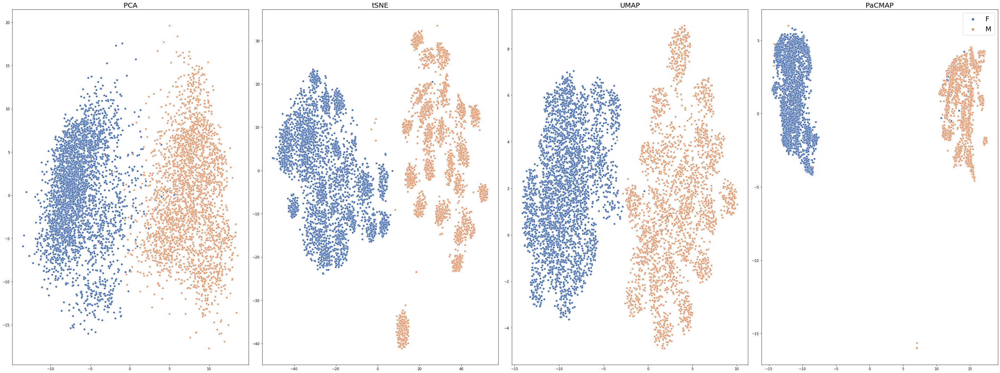

In [15]:
fig, ax = plt.subplots(1, 4, figsize=(40, 15))
optimize = 'Global'
reducer_names, params_list = get_reducers_params()
df = pd.read_csv(f'gender_features_scriptvsspon_dataset_217.csv', header=[0,1,2])
df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
for j, name in enumerate(reducer_names):
    visualize_embeddings(df, 'gender', axis=ax[j], opt_structure=optimize, red_name=name, plot_type='sns')
ax[j].legend(bbox_to_anchor=(1, 1), fontsize=20)
plt.tight_layout()

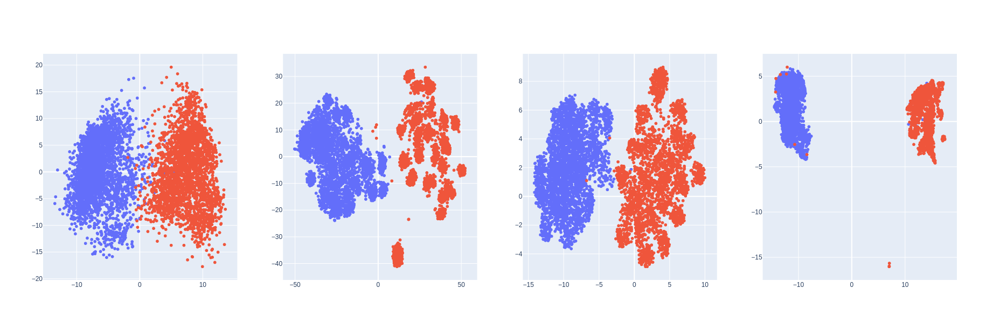

In [37]:
fig = make_subplots(rows=1, cols=4)
optimize = 'Global'
reducer_names, params_list = get_reducers_params()
df = pd.read_csv('gender_features_scriptvsspon_dataset_217.csv', header=[0,1,2])
df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
for j, name in enumerate(reducer_names):
    visualize_embeddings(df, 'gender', axis=fig, opt_structure=optimize, red_name=name, plot_type='plotly', row=1, col=j+1, hovertext=df['wav_file'])
fig.update_layout(
    autosize=False,
    width=1600,
    height=600, showlegend=False,)
fig.show()

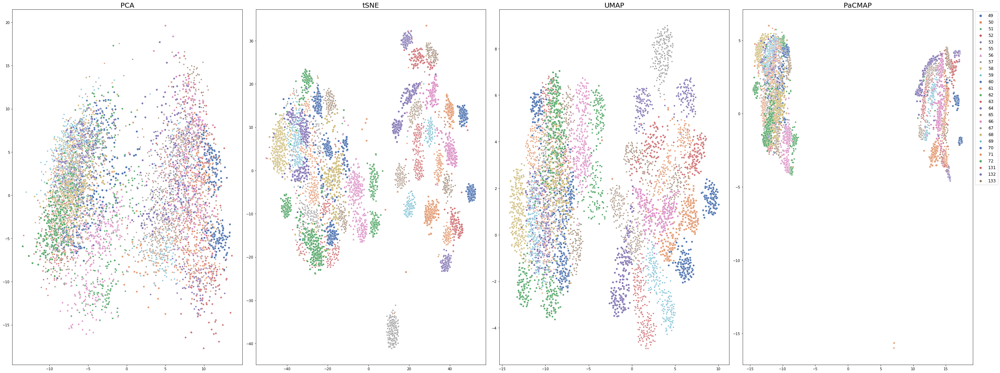

In [23]:
fig, ax = plt.subplots(1, 4, figsize=(40, 15))
optimize = 'Global'
reducer_names, params_list = get_reducers_params()
df = pd.read_csv(f'gender_features_scriptvsspon_dataset_217.csv', header=[0,1,2])
df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
for j, name in enumerate(reducer_names):
    visualize_embeddings(df, 'id', axis=ax[j], opt_structure=optimize, red_name=name, plot_type='sns')
ax[j].legend(bbox_to_anchor=(1, 1), fontsize=12)
plt.tight_layout()

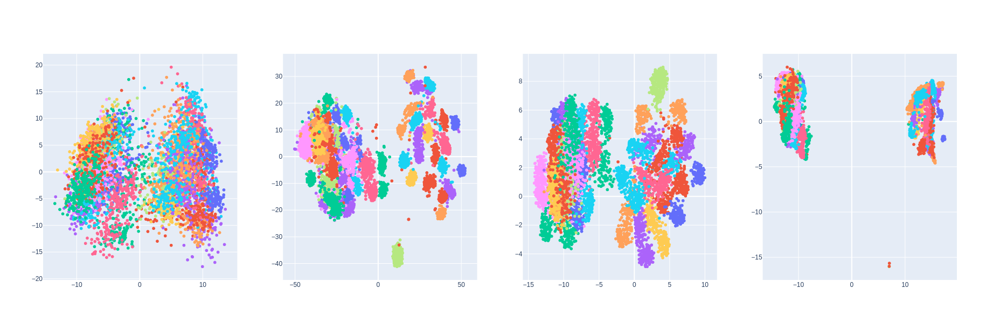

In [24]:
fig = make_subplots(rows=1, cols=4)
optimize = 'Global'
reducer_names, params_list = get_reducers_params()
df = pd.read_csv('gender_features_scriptvsspon_dataset_217.csv', header=[0,1,2])
df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
for j, name in enumerate(reducer_names):
    max_idx = metrics[optimize].loc[(metrics.Method==name)].idxmax()
    metric = [metrics['Local'].iloc[max_idx], metrics['Global'].iloc[max_idx]]
    visualize_embeddings(df, 'id', axis=fig, opt_structure=optimize, red_name=name, plot_type='plotly', row=1, col=j+1, hovertext=df['wav_file'])
fig.update_layout(
    autosize=False,
    width=1600,
    height=600, showlegend=False,)
fig.show()

### *"Genderless"*-related Features Analysis

In [36]:
def visualize_embeddings(df, label_name, metrics=[], axis=[], acoustic_param={}, opt_structure='Local', plot_type='sns', red_name='PCA', row=1, col=1, hovertext='', label='spon'):
    if plot_type == 'sns':
        sns.scatterplot(data=df, x=(red_name, opt_structure, 'Dim1'), y=(red_name, opt_structure, 'Dim2'), hue=label_name
                        , style=label_name, palette='deep', ax=axis)
        axis.set(xlabel=None, ylabel=None)
        axis.get_legend().remove()
        if len(metrics) != 0:
            axis.set_title(f'{red_name}: KNN={metrics[0]:0.2f}, CPD={metrics[1]:0.2f}', fontsize=15)
        else:
            axis.set_title(f'{red_name}', fontsize=15)
    else:
        traces = px.scatter(x=df[red_name, opt_structure, 'Dim1'], y=df[red_name, opt_structure, 'Dim2'], color=df[label_name].astype(str), hover_name=hovertext, title=f'{red_name}: KNN={metrics[0]:0.2f}, CPD={metrics[1]:0.2f}')
        traces.layout.update(showlegend=False)
        axis.add_traces(
            list(traces.select_traces()),
            rows=row, cols=col
        )

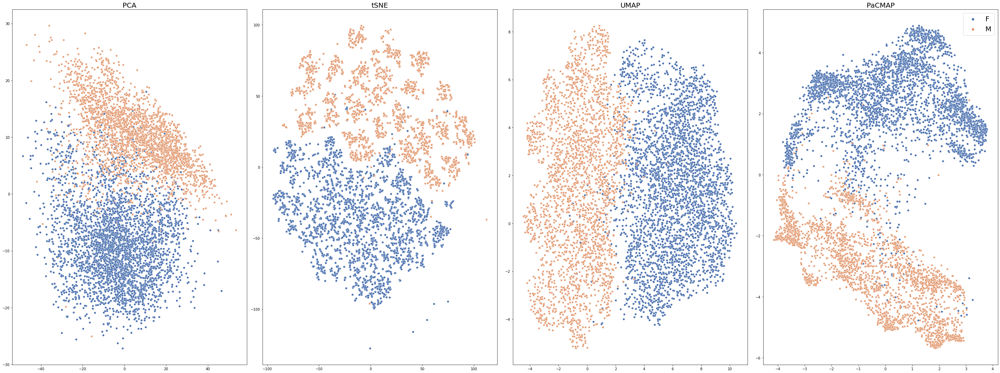

In [25]:
fig, ax = plt.subplots(1, 4, figsize=(40, 15))
optimize = 'Global'
reducer_names, params_list = get_reducers_params()
df = pd.read_csv(f'genderless_features_scriptvsspon_dataset_217.csv', header=[0,1,2])
df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
for j, name in enumerate(reducer_names):
    visualize_embeddings(df, 'gender', axis=ax[j], opt_structure=optimize, red_name=name, plot_type='sns')
ax[j].legend(bbox_to_anchor=(1, 1), fontsize=20)
plt.tight_layout()

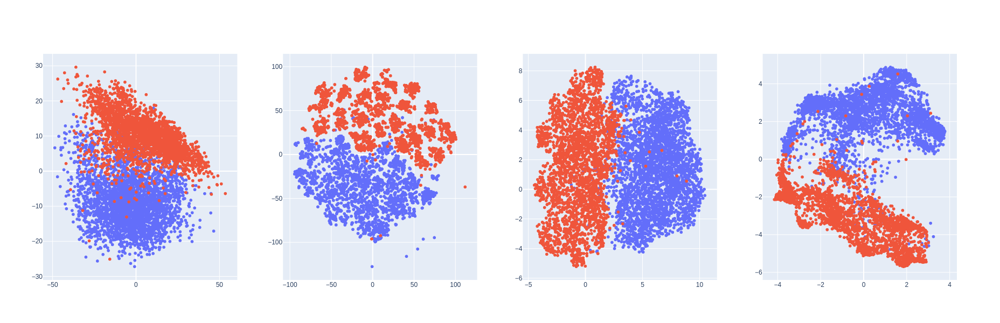

In [26]:
fig = make_subplots(rows=1, cols=4)
optimize = 'Global'
reducer_names, params_list = get_reducers_params()
df = pd.read_csv('genderless_features_scriptvsspon_dataset_217.csv', header=[0,1,2])
df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
for j, name in enumerate(reducer_names):
    visualize_embeddings(df, 'gender', axis=fig, opt_structure=optimize, red_name=name, plot_type='plotly', row=1, col=j+1, hovertext=df['wav_file'])
fig.update_layout(
    autosize=False,
    width=1600,
    height=600, showlegend=False,)
fig.show()

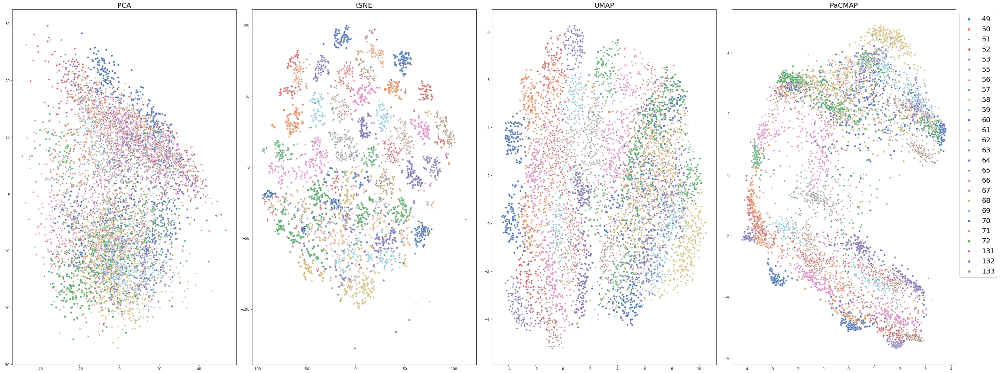

In [27]:
fig, ax = plt.subplots(1, 4, figsize=(40, 15))
optimize = 'Global'
reducer_names, params_list = get_reducers_params()
df = pd.read_csv(f'genderless_features_scriptvsspon_dataset_217.csv', header=[0,1,2])
df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
for j, name in enumerate(reducer_names):
    visualize_embeddings(df, 'id', axis=ax[j], opt_structure=optimize, red_name=name, plot_type='sns')
ax[j].legend(bbox_to_anchor=(1, 1), fontsize=20)
plt.tight_layout()

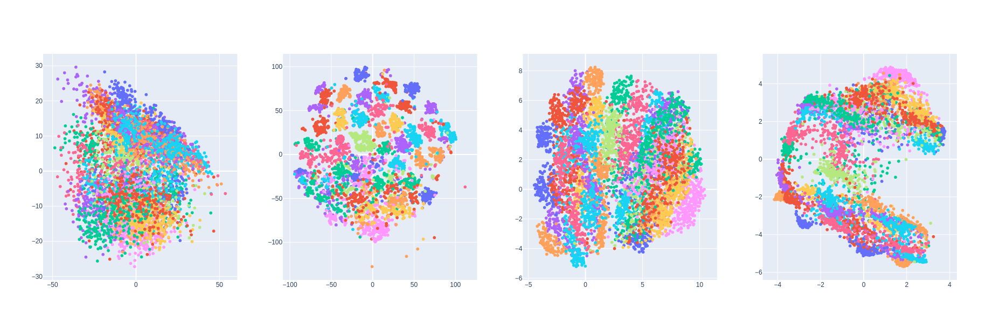

In [28]:
fig = make_subplots(rows=1, cols=4)
optimize = 'Global'
reducer_names, params_list = get_reducers_params()
df = pd.read_csv('genderless_features_scriptvsspon_dataset_217.csv', header=[0,1,2])
df.rename(columns={'Unnamed: 17_level_1': '', 'Unnamed: 17_level_2': '', 'Unnamed: 18_level_1': '', 'Unnamed: 18_level_2': '', 'Unnamed: 19_level_1': '', 'Unnamed: 19_level_2': ''},inplace=True)
for j, name in enumerate(reducer_names):
    max_idx = metrics[optimize].loc[(metrics.Method==name)].idxmax()
    metric = [metrics['Local'].iloc[max_idx], metrics['Global'].iloc[max_idx]]
    visualize_embeddings(df, 'id', axis=fig, opt_structure=optimize, red_name=name, plot_type='plotly', row=1, col=j+1, hovertext=df['wav_file'])
fig.update_layout(
    autosize=False,
    width=1600,
    height=600, showlegend=False,)
fig.show()